Saving figure at pic/image_0.png.
Saving figure at pic/image_1.png.
Saving figure at pic/image_2.png.
Saving figure at pic/image_3.png.
Saving figure at pic/image_4.png.
Saving figure at pic/image_5.png.
Saving figure at pic/image_6.png.
Saving figure at pic/image_7.png.
Saving figure at pic/image_8.png.
Saving figure at pic/image_9.png.
Saving figure at pic/image_10.png.
Saving figure at pic/image_11.png.
Saving figure at pic/image_12.png.
Saving figure at pic/image_13.png.
Saving figure at pic/image_14.png.
Saving figure at pic/image_15.png.
Saving figure at pic/image_16.png.
Saving figure at pic/image_17.png.
Saving figure at pic/image_18.png.
Saving figure at pic/image_19.png.
Saving figure at pic/image_20.png.
Saving figure at pic/image_21.png.
Saving figure at pic/image_22.png.
Saving figure at pic/image_23.png.
Saving figure at pic/image_24.png.
Saving figure at pic/image_25.png.
Saving figure at pic/image_26.png.
Saving figure at pic/image_27.png.
Saving figure at pic/image_28.

Saving figure at pic/image_231.png.
Saving figure at pic/image_232.png.
Saving figure at pic/image_233.png.
Saving figure at pic/image_234.png.
Saving figure at pic/image_235.png.
Saving figure at pic/image_236.png.
Saving figure at pic/image_237.png.
Saving figure at pic/image_238.png.
Saving figure at pic/image_239.png.
Saving figure at pic/image_240.png.
Saving figure at pic/image_241.png.
Saving figure at pic/image_242.png.
Saving figure at pic/image_243.png.
Saving figure at pic/image_244.png.
Saving figure at pic/image_245.png.
Saving figure at pic/image_246.png.
Saving figure at pic/image_247.png.
Saving figure at pic/image_248.png.
Saving figure at pic/image_249.png.
Saving figure at pic/image_250.png.
Saving figure at pic/image_251.png.
Saving figure at pic/image_252.png.
Saving figure at pic/image_253.png.
Saving figure at pic/image_254.png.
Saving figure at pic/image_255.png.
Saving figure at pic/image_256.png.
Saving figure at pic/image_257.png.
Saving figure at pic/image_2

KeyboardInterrupt: 

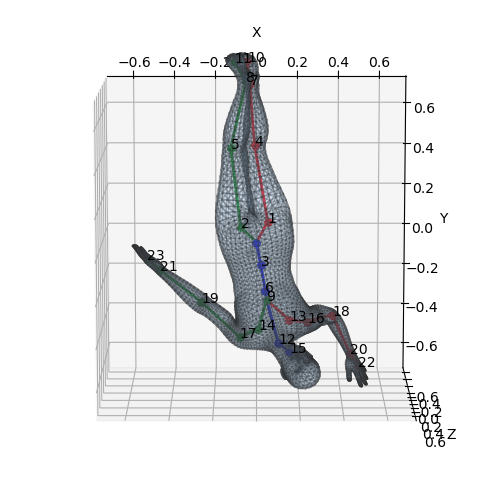

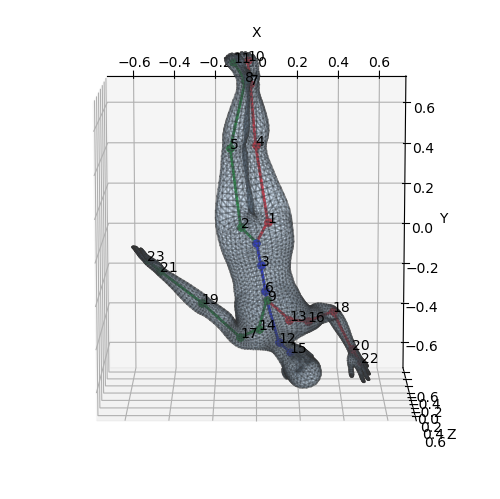

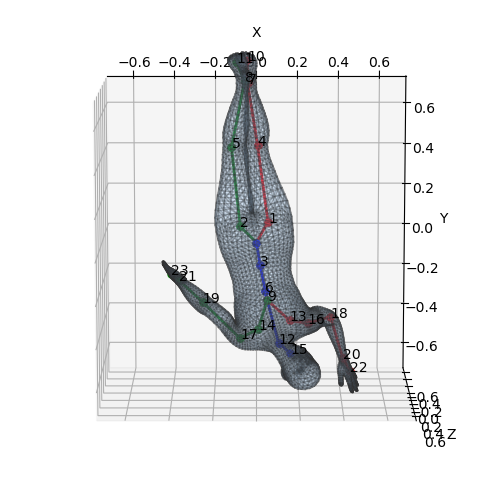

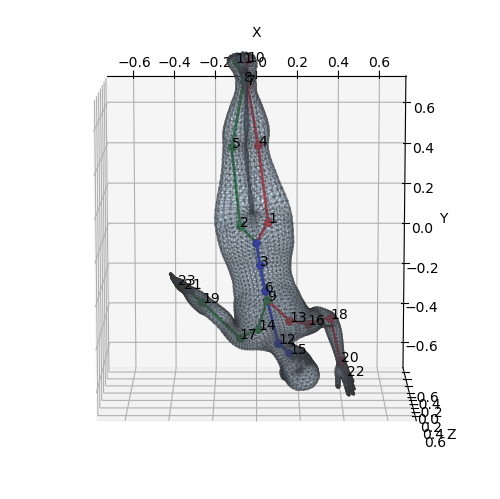

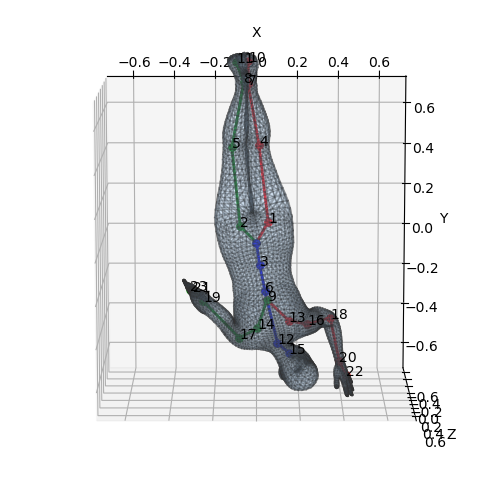

...

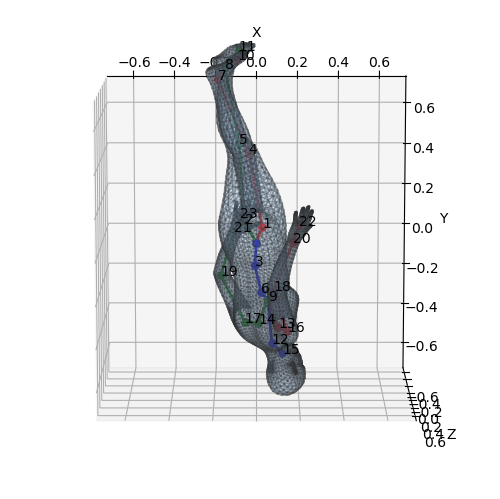

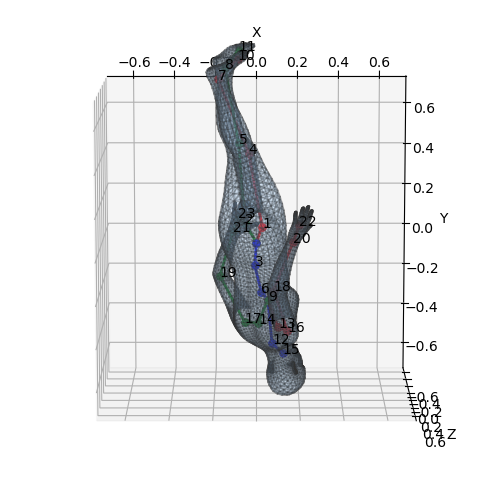

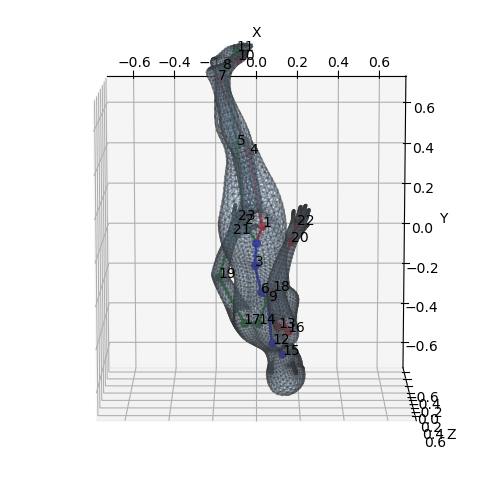

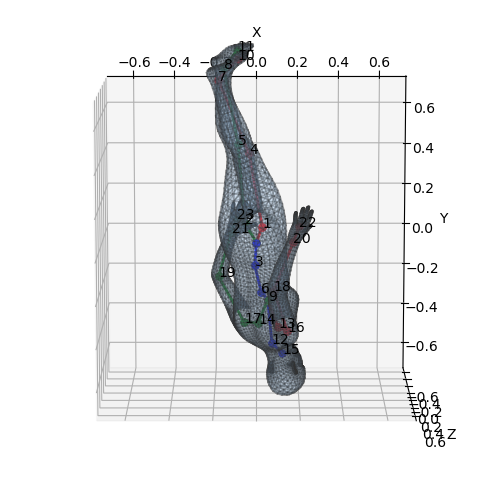

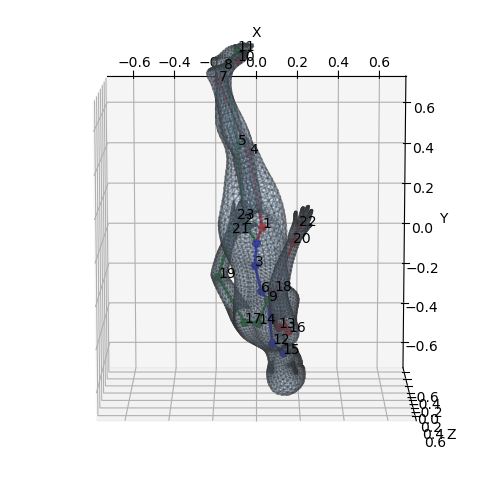

In [ ]:
import numpy as np
import torch
from smplpytorch.pytorch.smpl_layer import SMPL_Layer
from display_utils import display_model

cuda = False
batch_size = 1
smpl_layer = SMPL_Layer(center_idx=0, gender='neutral', model_root='smplpytorch/native/models')
file = np.load("C:/Users/lalas/Downloads/file.npz")
for frame_index in range(file['global_orient'].shape[0]-1):
    global_orient = file['global_orient'][frame_index]
    body_shape = file['betas'][frame_index]
    body_pose = file['body_pose'][frame_index]
    #print("Frame Index:", frame_index)
    #print("Shapes:", global_orient.shape, body_shape.shape, body_pose.shape)

    pose_params = torch.cat([torch.tensor(global_orient).view(1, -1), torch.tensor(body_pose).view(1, -1)], dim=1)
    shape_params = torch.tensor(body_shape.reshape(batch_size, -1), dtype=torch.float32)
    #print("Tensor Shapes:", pose_params.shape, shape_params.shape)
    verts, Jtr = smpl_layer(pose_params, th_betas=shape_params)
    #print(Jtr.shape)
    torch.save(Jtr, f'joint/joint_{frame_index}.pt')
    display_model({'verts': verts.cpu().detach(), 'joints': Jtr.cpu().detach()}, model_faces=smpl_layer.th_faces,with_joints=True, kintree_table=smpl_layer.kintree_table, savepath=f'pic/image_{frame_index}.png', show=False)

print("Processing complete.")